In [65]:
from pathlib import Path
import nilearn
from nilearn import image
from nilearn import datasets
from nilearn import plotting
from nilearn.input_data import NiftiSpheresMasker
from nilearn.input_data import NiftiMasker
from nilearn.input_data import NiftiLabelsMasker
import numpy as np
import timeit
from datetime import datetime
from joblib import Memory
import os
import pylab as plt
import nibabel as nib
import pandas as pd
import random
import scipy.stats as stats
import seaborn as sns
from matplotlib.backends.backend_pdf import PdfPages

### To get hp2000_clean.nii.gz files you must mount /misc/files_hcp/S500_1 

date and time = 13/06/2022 14:14:25
Seed-to-voxel correlation Fisher-z transformed: min = -0.681; max = 0.901
date and time = 13/06/2022 14:14:27


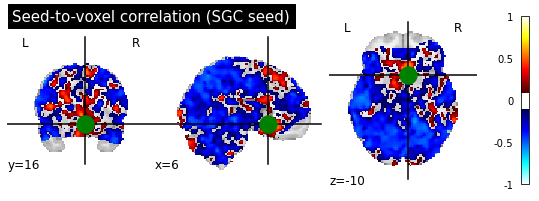

In [8]:
# SGC Z CORRELATION MAP SINGLE SUBJECT IMPLEMENTATION W/ DOT PRODUCT CORRELATION

# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("date and time =", dt_string)	

mem = Memory('nilearn_cache') 

func_file='/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz'

sgc_coords=[(6, 16, -10)]
seed_masker = NiftiSpheresMasker(sgc_coords, radius=10, detrend=True,
                                 standardize=True, low_pass=0.1,
                                 high_pass=0.01, t_r=0.72,
                                 memory='nilearn_cache',
                                 memory_level=1, verbose=0)

seed_time_series = seed_masker.fit_transform(func_file)


brain_masker = NiftiMasker(
    smoothing_fwhm=6,
    detrend=True, standardize=True,
    low_pass=0.1, high_pass=0.01, t_r=0.72,
    memory='nilearn_cache', memory_level=1, verbose=0)

brain_time_series = brain_masker.fit_transform(func_file)

seed_to_voxel_correlations = (np.dot(brain_time_series.T, seed_time_series) /
                              seed_time_series.shape[0]
                              )

seed_to_voxel_correlations_img = brain_masker.inverse_transform(
    seed_to_voxel_correlations.T)
display = plotting.plot_stat_map(seed_to_voxel_correlations_img,
                                 threshold=0.1, vmax=1,
                                 cut_coords=sgc_coords[0],
                                 title="Seed-to-voxel correlation (SGC seed)"
                                 )
display.add_markers(marker_coords=sgc_coords, marker_color='g',  marker_size=300)
seed_to_voxel_correlations_fisher_z = np.arctanh(seed_to_voxel_correlations)
print("Seed-to-voxel correlation Fisher-z transformed: min = %.3f; max = %.3f"
      % (seed_to_voxel_correlations_fisher_z.min(),
         seed_to_voxel_correlations_fisher_z.max()
         )
      )

# Finally, we can transform the correlation array back to a Nifti image
# object, that we can save.
seed_to_voxel_correlations_fisher_z_img = brain_masker.inverse_transform(
    seed_to_voxel_correlations_fisher_z.T)
seed_to_voxel_correlations_fisher_z_img.to_filename(
    '/src/notebooks/output/S500_1/101107/rfMRI_REST1_LR/dot_product_sgc_seed_correlation_z.nii.gz')

# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("date and time =", dt_string)	



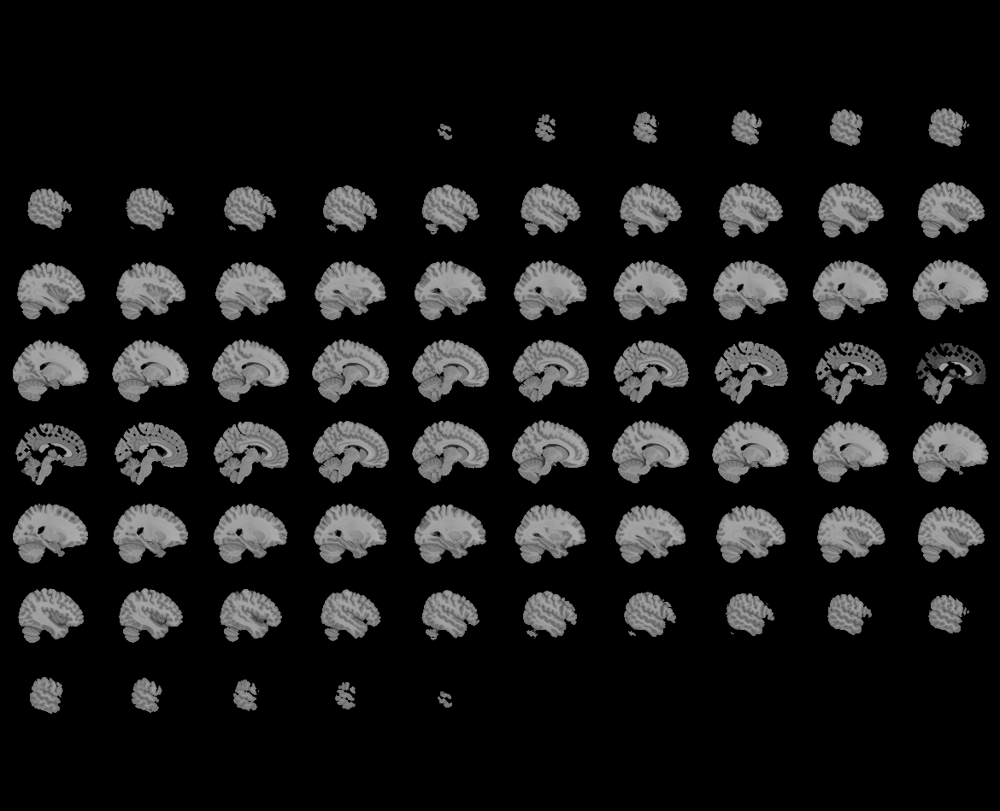
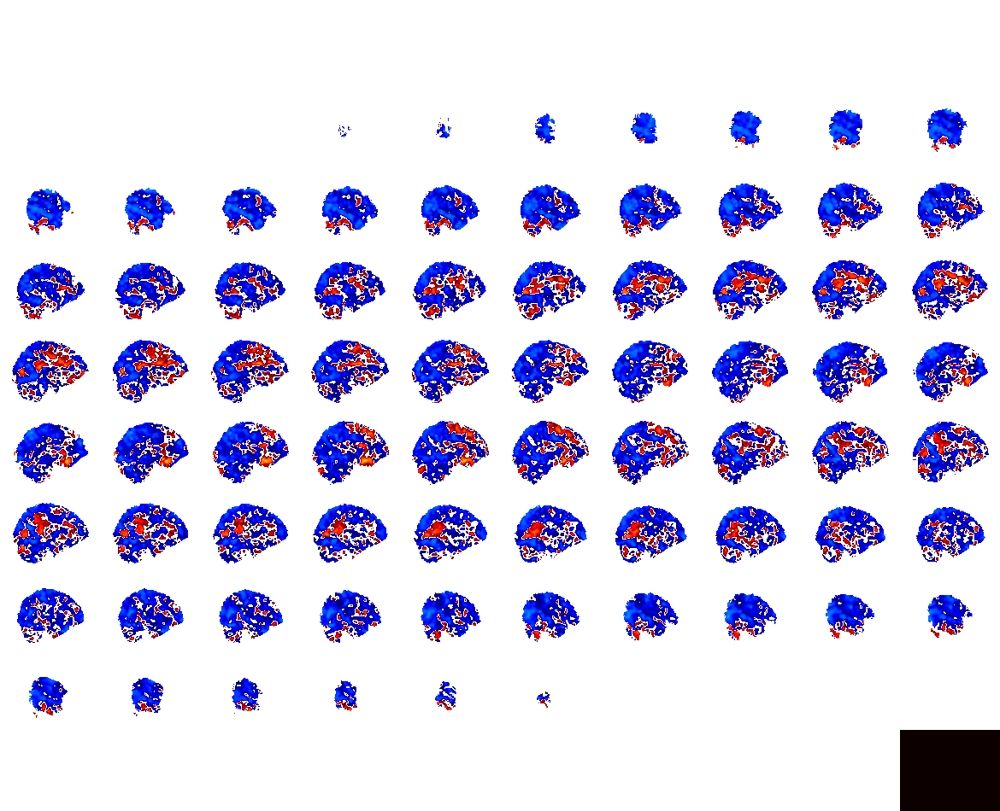

In [9]:
plotting.view_img(seed_to_voxel_correlations_img,
                                 threshold=0.1, vmax=1,
                                 cut_coords=sgc_coords[0],
                                 title="Seed-to-voxel correlation (SGC seed)"
                                 )

date and time = 13/06/2022 16:04:42


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 1.10s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.51s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self.

Seed-to-voxel correlation Fisher-z transformed: min = -0.683; max = 0.701
date and time = 13/06/2022 16:07:15


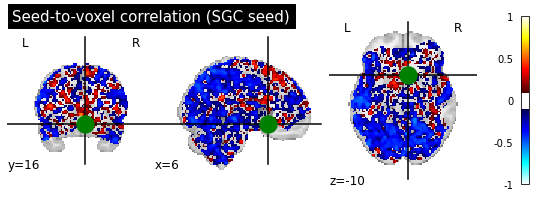

In [15]:
# SGC Z CORRELATION MAP SINGLE SUBJECT IMPLEMENTATION W/ FORMULAIC CORRELATION

#from nilearn.interfaces.fmriprep import load_confounds

def corr2_coeff(A, B):
    A_bar = np.mean(A, axis=1) # flattens A
    A_bar = A_bar[:, np.newaxis] 
    A_mA = A - A_bar
    B_mB = B - np.mean(B)
    
    # get dot product of every row of A_mA with B_mB
    numerators = A_mA.dot(B_mB)
    
    # Sum of squares
    A_sqs = np.sum(np.square(A_mA), axis=1) # get columnwise sum for A because A is a matrix
    B_sq = np.sum(np.square(B_mB))
    
    denoms = np.sqrt(A_sqs * B_sq) # scalar times vector 
    denoms = denoms[:, np.newaxis]
    
    # Finally get corr coeff
    return (numerators/denoms)
   
# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("date and time =", dt_string)

img_path = Path('/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz')
#conf_path = '/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST1_LR/Movement_Regressors.txt'
out = Path(Path.cwd().as_posix() + '/output/' + img_path.parts[3] + '/' + img_path.parts[4] + '/' + img_path.parts[7])
if not out.exists():
    out.mkdir(parents=True)

func_file = path.as_posix()

sgc_coords=[(6, 16, -10)]

seed_masker = NiftiSpheresMasker(sgc_coords, radius=10, detrend=True,
                                 standardize=True, low_pass=0.1,
                                 high_pass=0.01, t_r=0.72, 
                                 memory='nilearn_cache',
                                 memory_level=1, verbose=0)
seed_time_series = seed_masker.fit_transform(func_file)

brain_masker = NiftiMasker(
    smoothing_fwhm=4,
    detrend=True, mask_strategy="epi", standardize=True,
    low_pass=0.1, high_pass=0.01, t_r=0.72, 
    memory='nilearn_cache', memory_level=1, verbose=0)
brain_time_series = brain_masker.fit_transform(func_file)

seed_to_voxel_correlations = (np.dot(brain_time_series.T, seed_time_series) / seed_time_series.shape[0])
seed_to_voxel_correlations_img = brain_masker.inverse_transform(seed_to_voxel_correlations.T)

display = plotting.plot_stat_map(seed_to_voxel_correlations_img,
                                 threshold=0.1, vmax=1,
                                 cut_coords=sgc_coords[0],
                                 title="Seed-to-voxel correlation (SGC seed)"
                                 )
display.add_markers(marker_coords=sgc_coords, marker_color='g',  marker_size=300)
seed_to_voxel_correlations_fisher_z = np.arctanh(seed_to_voxel_correlations)
print("Seed-to-voxel correlation Fisher-z transformed: min = %.3f; max = %.3f"
      % (seed_to_voxel_correlations_fisher_z.min(),
         seed_to_voxel_correlations_fisher_z.max()
         )
      )

# Finally, we can transform the correlation array back to a Nifti image
# object, that we can save.
seed_to_voxel_correlations_fisher_z_img = brain_masker.inverse_transform(
    seed_to_voxel_correlations_fisher_z.T)
seed_to_voxel_correlations_fisher_z_img.to_filename(
    out.as_posix()+'/sgc_seed_correlation_z.nii.gz')

# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("date and time =", dt_string)



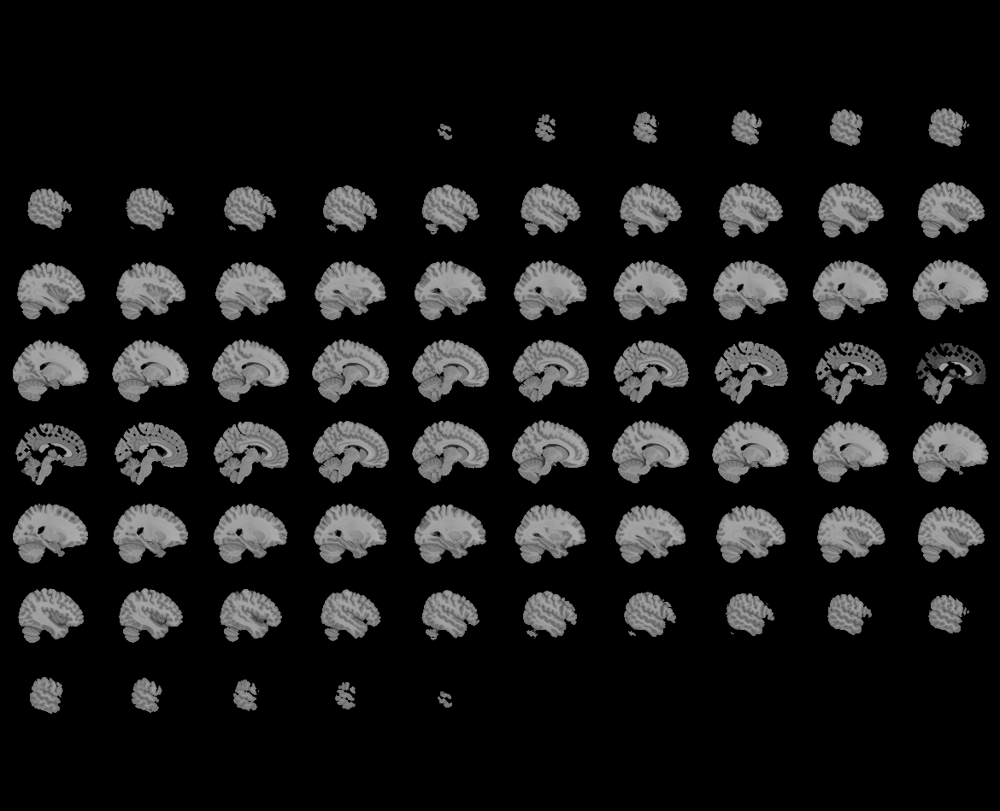
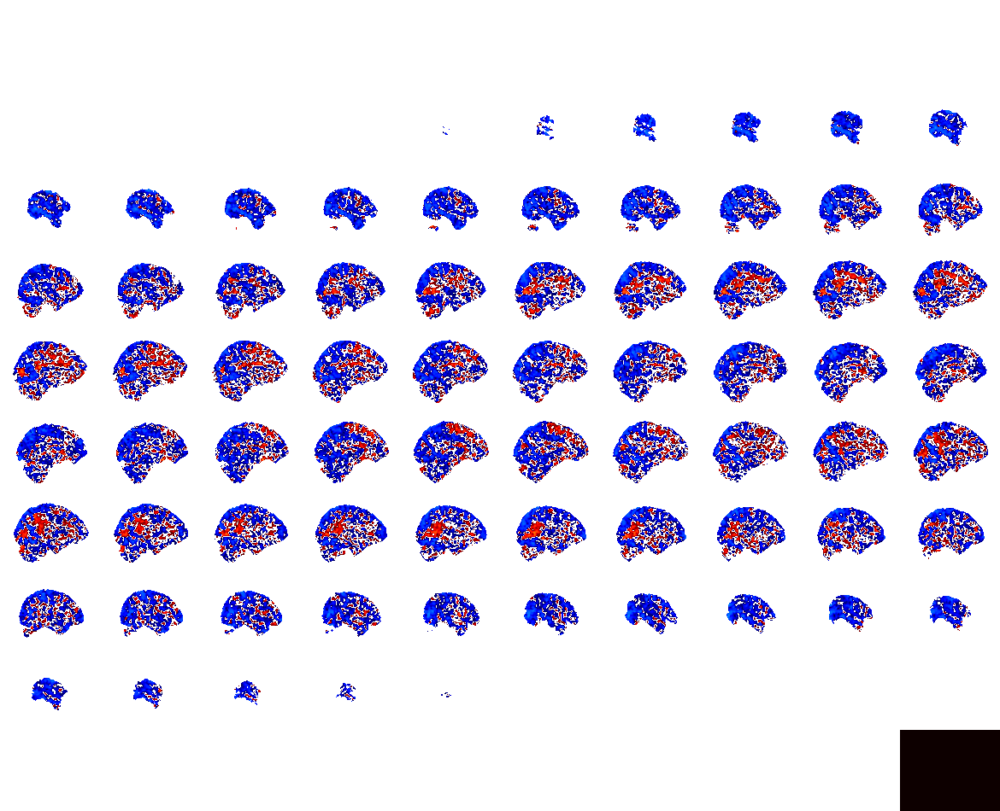

In [16]:
plotting.view_img(seed_to_voxel_correlations_img,
                                 threshold=0.1, vmax=1,
                                 cut_coords=sgc_coords[0],
                                 title="Seed-to-voxel correlation (SGC seed)"
                                 )

In [2]:
from pathlib import Path
for path in Path('/src/notebooks/S500_1/').rglob('*/MNINonLinear/Results/*/*_hp2000_clean.nii.gz'):
    print(path)

/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101107/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101309/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101309/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101309/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101309/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/103414/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/103414/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz


/src/notebooks/S500_1/120111/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/122620/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/122620/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/122620/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/122620/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/124826/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/124826/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/124826/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/124826/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/125525/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz


/src/notebooks/S500_1/100408/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101006/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101006/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101006/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101006/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101410/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101410/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101915/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/101915/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/101915/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz


/src/notebooks/S500_1/117122/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/117324/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/117324/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/117324/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/117324/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/118528/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/118528/MNINonLinear/Results/rfMRI_REST1_RL/rfMRI_REST1_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/118528/MNINonLinear/Results/rfMRI_REST2_LR/rfMRI_REST2_LR_hp2000_clean.nii.gz
/src/notebooks/S500_1/118528/MNINonLinear/Results/rfMRI_REST2_RL/rfMRI_REST2_RL_hp2000_clean.nii.gz
/src/notebooks/S500_1/118730/MNINonLinear/Results/rfMRI_REST1_LR/rfMRI_REST1_LR_hp2000_clean.nii.gz


KeyboardInterrupt: 

Seed-to-voxel correlation Fisher-z transformed: min = -0.471; max = 0.671
Time to calculate 1 correlation maps:  95.76951194321737


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.415; max = 0.504
Time to calculate 2 correlation maps:  618.3393140910193


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.399; max = 0.653
Time to calculate 3 correlation maps:  1033.7160502951592


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.612; max = 0.618
Time to calculate 4 correlation maps:  1472.201361487154


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.484; max = 0.597
Time to calculate 5 correlation maps:  1834.019090520218


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.428; max = 0.511
Time to calculate 6 correlation maps:  2198.394264881965


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.418; max = 0.549
Time to calculate 7 correlation maps:  2529.6449124789797


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.652; max = 0.781
Time to calculate 8 correlation maps:  2923.811867231969


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.588; max = 0.589
Time to calculate 9 correlation maps:  3247.9281531278975


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.628; max = 0.666
Time to calculate 10 correlation maps:  3714.483652473893


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.523; max = 0.507
Time to calculate 11 correlation maps:  4041.2386880940758


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:428: UserWarning: Persisting input arguments took 0.61s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  self.mask_img_ = self._cache(compute_mask, ignore=['verbose'])(
/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.492; max = 0.509
Time to calculate 12 correlation maps:  4470.897063434124


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.479; max = 0.527
Time to calculate 13 correlation maps:  4838.184474061243


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.403; max = 0.465
Time to calculate 14 correlation maps:  5287.0600754879415


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.567; max = 0.585
Time to calculate 15 correlation maps:  5608.251911519095


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 0.56s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.570; max = 0.620


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.58s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Time to calculate 16 correlation maps:  6072.674087317195


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.462; max = 0.643
Time to calculate 17 correlation maps:  6427.386660256889


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.466; max = 0.517
Time to calculate 18 correlation maps:  6851.388454415835


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.605; max = 0.759
Time to calculate 19 correlation maps:  7219.212645689957


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 0.59s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.564; max = 0.684
Time to calculate 20 correlation maps:  7707.071141810156


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/plotting/displays.py:666: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = plt.figure(figure, figsize=figsize,


Seed-to-voxel correlation Fisher-z transformed: min = -0.545; max = 0.713
Time to calculate 21 correlation maps:  8037.04834274482


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:442: UserWarning: Persisting input arguments took 0.55s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  self.mask_img_ = self._cache(image.resample_img)(
/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.518; max = 0.640
Time to calculate 22 correlation maps:  8468.881719993893


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.513; max = 1.056
Time to calculate 23 correlation maps:  8823.327717070933


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.556; max = 0.523
Time to calculate 24 correlation maps:  9257.138691529166


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.583; max = 0.615
Time to calculate 25 correlation maps:  9601.854990280233


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.558; max = 0.605
Time to calculate 26 correlation maps:  10070.321474664845


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.599; max = 0.747
Time to calculate 27 correlation maps:  10539.050134500954


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.450; max = 0.634
Time to calculate 28 correlation maps:  10851.564077633899


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.373; max = 0.516
Time to calculate 29 correlation maps:  11177.14821883291


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.648; max = 0.842
Time to calculate 30 correlation maps:  11562.372839617077


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.632; max = 0.592
Time to calculate 31 correlation maps:  11831.496360702906


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.652; max = 0.702
Time to calculate 32 correlation maps:  12104.34429173218


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.583; max = 0.546
Time to calculate 33 correlation maps:  12486.906405603979


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.508; max = 0.591
Time to calculate 34 correlation maps:  12767.160082471091


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.679; max = 0.842
Time to calculate 35 correlation maps:  13071.271593171172


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.709; max = 0.732
Time to calculate 36 correlation maps:  13360.403354618233


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.566; max = 0.785
Time to calculate 37 correlation maps:  13687.694280200172


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.575; max = 0.742
Time to calculate 38 correlation maps:  14004.373500525951


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.466; max = 0.718
Time to calculate 39 correlation maps:  14331.491338901222


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.480; max = 0.566
Time to calculate 40 correlation maps:  14612.93324802816


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.549; max = 0.682
Time to calculate 41 correlation maps:  14914.095301855821


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.424; max = 0.567
Time to calculate 42 correlation maps:  15215.689163018018


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.629; max = 0.605
Time to calculate 43 correlation maps:  15504.641759457998


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.557; max = 0.615
Time to calculate 44 correlation maps:  15803.34812517697


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.492; max = 0.628
Time to calculate 45 correlation maps:  16087.917316756211


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.464; max = 0.538
Time to calculate 46 correlation maps:  16432.690812673885


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.435; max = 0.582
Time to calculate 47 correlation maps:  16818.54894602485


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.622; max = 0.673
Time to calculate 48 correlation maps:  17129.28540688986


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.484; max = 0.637
Time to calculate 49 correlation maps:  17409.902020228095


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.565; max = 0.779
Time to calculate 50 correlation maps:  17672.637726671994


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.465; max = 0.785
Time to calculate 51 correlation maps:  17977.535007026978


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.428; max = 0.646
Time to calculate 52 correlation maps:  18240.35222605709


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.460; max = 0.564
Time to calculate 53 correlation maps:  18593.41730572004


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.682; max = 0.759
Time to calculate 54 correlation maps:  18910.438610888086


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.340; max = 0.516
Time to calculate 55 correlation maps:  19265.036492453888


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.615; max = 0.668
Time to calculate 56 correlation maps:  19660.9304789952


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.704; max = 0.761
Time to calculate 57 correlation maps:  20008.564269552007


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.373; max = 0.549
Time to calculate 58 correlation maps:  20304.323640491813


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.451; max = 0.620
Time to calculate 59 correlation maps:  20671.60233849706


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.447; max = 0.503
Time to calculate 60 correlation maps:  20956.098495960236


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.536; max = 0.650
Time to calculate 61 correlation maps:  21309.40666106483


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:442: UserWarning: Persisting input arguments took 0.51s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  self.mask_img_ = self._cache(image.resample_img)(
/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.573; max = 0.651
Time to calculate 62 correlation maps:  21585.057702512946


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.526; max = 0.538
Time to calculate 63 correlation maps:  21885.189943092875


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.478; max = 0.663
Time to calculate 64 correlation maps:  22221.64436805714


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.503; max = 0.627
Time to calculate 65 correlation maps:  22489.81078306306


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.508; max = 0.651
Time to calculate 66 correlation maps:  22788.559971523006


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.661; max = 0.764
Time to calculate 67 correlation maps:  23063.37522402592


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.693; max = 0.850
Time to calculate 68 correlation maps:  23385.948579964228


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.566; max = 0.641
Time to calculate 69 correlation maps:  23688.18915672181


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.684; max = 0.745
Time to calculate 70 correlation maps:  23980.99504381325


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.612; max = 0.606
Time to calculate 71 correlation maps:  24389.102084924


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -1.854; max = 1.908
Time to calculate 72 correlation maps:  24790.279040114023


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.434; max = 0.573
Time to calculate 73 correlation maps:  25081.542552033905


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.650; max = 0.686
Time to calculate 74 correlation maps:  25415.89782243222


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.530; max = 0.689
Time to calculate 75 correlation maps:  25732.830745675135


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.708; max = 0.703
Time to calculate 76 correlation maps:  26067.672665496822


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.538; max = 0.625
Time to calculate 77 correlation maps:  26561.72219828982


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.468; max = 0.705
Time to calculate 78 correlation maps:  26942.076465810183


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.553; max = 0.697
Time to calculate 79 correlation maps:  27231.068081974052


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.514; max = 0.570
Time to calculate 80 correlation maps:  27554.45596962096


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.518; max = 0.708
Time to calculate 81 correlation maps:  27860.202319838107


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 1.46s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.789; max = 0.964
Time to calculate 82 correlation maps:  28215.15658278903


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.659; max = 0.830
Time to calculate 83 correlation maps:  28574.027978972066


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.510; max = 0.699
Time to calculate 84 correlation maps:  28912.62889920408


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.488; max = 0.671
Time to calculate 85 correlation maps:  29268.69436549209


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.635; max = 0.644
Time to calculate 86 correlation maps:  29641.15042554494


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.516; max = 0.696
Time to calculate 87 correlation maps:  30077.725050284993


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.373; max = 0.538
Time to calculate 88 correlation maps:  30522.506927886046


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.550; max = 0.509
Time to calculate 89 correlation maps:  30819.83881478198


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 0.99s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.685; max = 0.785
Time to calculate 90 correlation maps:  31179.915031882934


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.577; max = 0.623
Time to calculate 91 correlation maps:  31579.7338594459


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.647; max = 0.786
Time to calculate 92 correlation maps:  31920.207735170145


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.392; max = 0.451
Time to calculate 93 correlation maps:  32342.892853416968


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.532; max = 0.624
Time to calculate 94 correlation maps:  32897.50370658608


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.435; max = 0.554
Time to calculate 95 correlation maps:  33385.250979815144


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.416; max = 0.587
Time to calculate 96 correlation maps:  33824.716127276886


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.449; max = 0.588
Time to calculate 97 correlation maps:  34268.081782370806


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.563; max = 0.676
Time to calculate 98 correlation maps:  34655.644737005234


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 0.54s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.401; max = 0.593
Time to calculate 99 correlation maps:  35057.78129826393


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.601; max = 0.712
Time to calculate 100 correlation maps:  35452.499097642954


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 0.51s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.585; max = 0.681
Time to calculate 101 correlation maps:  35869.23433584208


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.473; max = 0.566
Time to calculate 102 correlation maps:  36272.02807519585


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.491; max = 0.625
Time to calculate 103 correlation maps:  36604.585605592


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.515; max = 0.639
Time to calculate 104 correlation maps:  36975.161135041155


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.657; max = 0.807
Time to calculate 105 correlation maps:  37433.2514263019


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.615; max = 0.827
Time to calculate 106 correlation maps:  37866.14669058891


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.632; max = 0.711
Time to calculate 107 correlation maps:  38292.51746875513


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.638; max = 0.783
Time to calculate 108 correlation maps:  38755.49143435294


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.454; max = 0.658
Time to calculate 109 correlation maps:  39151.111123101786


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.459; max = 0.497
Time to calculate 110 correlation maps:  39432.09349081805


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.464; max = 0.716
Time to calculate 111 correlation maps:  39726.3439658992


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.686; max = 0.671
Time to calculate 112 correlation maps:  40157.925019274


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.540; max = 0.549
Time to calculate 113 correlation maps:  40504.60976112308


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.501; max = 0.548
Time to calculate 114 correlation maps:  40804.03754881397


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.527; max = 0.577
Time to calculate 115 correlation maps:  41200.88501865417


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.362; max = 0.534
Time to calculate 116 correlation maps:  41574.53677065391


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.742; max = 0.869
Time to calculate 117 correlation maps:  41973.846960797906


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.746; max = 0.911
Time to calculate 118 correlation maps:  42307.745035653


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.597; max = 0.542
Time to calculate 119 correlation maps:  42592.44609364215


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 0.51s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.541; max = 0.566
Time to calculate 120 correlation maps:  43047.86743907211


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.364; max = 0.558
Time to calculate 121 correlation maps:  43392.33801809605


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.423; max = 0.508
Time to calculate 122 correlation maps:  43786.00782767497


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.602; max = 0.752
Time to calculate 123 correlation maps:  44147.416320324875


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 0.56s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.572; max = 0.716
Time to calculate 124 correlation maps:  44637.48169035697


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.467; max = 0.630
Time to calculate 125 correlation maps:  45124.30071296124


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.423; max = 0.494
Time to calculate 126 correlation maps:  45702.10736247618


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.584; max = 0.703
Time to calculate 127 correlation maps:  46113.79104386084


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.607; max = 0.797
Time to calculate 128 correlation maps:  46627.50852149911


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.637; max = 0.679
Time to calculate 129 correlation maps:  46941.39686317183


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.624; max = 0.657
Time to calculate 130 correlation maps:  47332.81536709191


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.494; max = 0.715
Time to calculate 131 correlation maps:  47703.132204188034


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.940; max = 0.925
Time to calculate 132 correlation maps:  48116.77442173194


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.561; max = 0.597
Time to calculate 133 correlation maps:  48435.70234078402


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.620; max = 0.950
Time to calculate 134 correlation maps:  48772.353715253994


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.586; max = 0.530
Time to calculate 135 correlation maps:  49316.52105950983


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.430; max = 0.574
Time to calculate 136 correlation maps:  49695.22549731098


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.610; max = 0.660
Time to calculate 137 correlation maps:  50086.133665916976


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.493; max = 0.552
Time to calculate 138 correlation maps:  50386.68394170422


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 1.59s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.621; max = 0.827
Time to calculate 139 correlation maps:  50659.40932235308


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.743; max = 0.705
Time to calculate 140 correlation maps:  50951.23800442414


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.628; max = 0.739
Time to calculate 141 correlation maps:  51236.61462684395


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.463; max = 0.541
Time to calculate 142 correlation maps:  51540.50628612796


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.572; max = 0.780
Time to calculate 143 correlation maps:  51870.472570566926


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.458; max = 0.649
Time to calculate 144 correlation maps:  52157.10529204784


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.511; max = 0.649
Time to calculate 145 correlation maps:  52443.51443021512


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.529; max = 0.651
Time to calculate 146 correlation maps:  52733.06766375201


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.441; max = 0.517
Time to calculate 147 correlation maps:  53018.21589454403


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.509; max = 0.666
Time to calculate 148 correlation maps:  53384.1739286012


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.434; max = 0.553
Time to calculate 149 correlation maps:  53737.79155072197


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.478; max = 0.584
Time to calculate 150 correlation maps:  54024.03522428917


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.478; max = 0.568
Time to calculate 151 correlation maps:  54300.40538501507


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.565; max = 0.627
Time to calculate 152 correlation maps:  54587.80957980221


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 1.35s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.685; max = 0.666
Time to calculate 153 correlation maps:  54875.17085997388


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.470; max = 0.541
Time to calculate 154 correlation maps:  55156.90297417389


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.691; max = 0.748
Time to calculate 155 correlation maps:  55452.10986097995


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.493; max = 0.581
Time to calculate 156 correlation maps:  55744.1885544532


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.680; max = 0.759
Time to calculate 157 correlation maps:  56031.597304367926


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.561; max = 0.630
Time to calculate 158 correlation maps:  56388.14218327124


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.532; max = 0.593
Time to calculate 159 correlation maps:  56668.10550100403


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.685; max = 0.907
Time to calculate 160 correlation maps:  56960.39609835623


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.523; max = 0.586
Time to calculate 161 correlation maps:  57233.01402240386


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.411; max = 0.520
Time to calculate 162 correlation maps:  57501.23519515805


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.518; max = 0.635
Time to calculate 163 correlation maps:  57766.35992986616


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.657; max = 0.689
Time to calculate 164 correlation maps:  58117.54813498119


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.473; max = 0.528
Time to calculate 165 correlation maps:  58380.02964553097


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.467; max = 0.507
Time to calculate 166 correlation maps:  58652.91017585108


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.510; max = 0.503
Time to calculate 167 correlation maps:  58919.31291199615


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.562; max = 0.603
Time to calculate 168 correlation maps:  59249.704182070214


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.634; max = 0.721
Time to calculate 169 correlation maps:  59668.57993128104


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 0.53s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.727; max = 0.876
Time to calculate 170 correlation maps:  59940.916605085135


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 1.65s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.504; max = 0.645
Time to calculate 171 correlation maps:  60210.9956942182


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:518: UserWarning: Persisting input arguments took 0.62s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  data = self._cache(filter_and_mask,


Seed-to-voxel correlation Fisher-z transformed: min = -0.697; max = 0.810
Time to calculate 172 correlation maps:  60485.32366477791


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.581; max = 0.722
Time to calculate 173 correlation maps:  60764.2546299519


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.548; max = 0.625
Time to calculate 174 correlation maps:  61032.5999869192


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.458; max = 0.576
Time to calculate 175 correlation maps:  61377.49958944181


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.474; max = 0.639
Time to calculate 176 correlation maps:  61654.881457582116


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.481; max = 0.572
Time to calculate 177 correlation maps:  61936.03970520012


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.470; max = 0.613
Time to calculate 178 correlation maps:  62212.62251676386


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.541; max = 0.608
Time to calculate 179 correlation maps:  62483.44927478582


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.514; max = 0.577
Time to calculate 180 correlation maps:  62757.70983237587


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.360; max = 0.524
Time to calculate 181 correlation maps:  63037.53071117494


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.547; max = 0.669
Time to calculate 182 correlation maps:  63317.069166417234


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.500; max = 0.561
Time to calculate 183 correlation maps:  63589.84592123004


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.429; max = 0.542
Time to calculate 184 correlation maps:  63868.31079492811


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.453; max = 0.581
Time to calculate 185 correlation maps:  64146.16585717397


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.493; max = 0.664
Time to calculate 186 correlation maps:  64516.7820301312


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.518; max = 0.616
Time to calculate 187 correlation maps:  64789.12365031894


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.587; max = 0.666
Time to calculate 188 correlation maps:  65066.62291741418


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 0.65s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.482; max = 0.605
Time to calculate 189 correlation maps:  65358.604989359155


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.569; max = 0.609
Time to calculate 190 correlation maps:  65647.09721593605


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.484; max = 0.567
Time to calculate 191 correlation maps:  66108.04878242221


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.418; max = 0.460
Time to calculate 192 correlation maps:  66394.16116868891


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.400; max = 0.562
Time to calculate 193 correlation maps:  66681.72298921691


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.522; max = 0.615
Time to calculate 194 correlation maps:  66974.88682579016


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.670; max = 0.831
Time to calculate 195 correlation maps:  67250.91783198295


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.507; max = 0.449
Time to calculate 196 correlation maps:  67551.90031067282


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.489; max = 0.601
Time to calculate 197 correlation maps:  67832.18384733191


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.622; max = 0.833
Time to calculate 198 correlation maps:  68112.50908572786


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.779; max = 0.680
Time to calculate 199 correlation maps:  68398.00783820217


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.511; max = 0.656
Time to calculate 200 correlation maps:  68704.01814401802


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.626; max = 0.649
Time to calculate 201 correlation maps:  69070.74623956392


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.630; max = 0.717
Time to calculate 202 correlation maps:  69371.61764047807


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.580; max = 0.714
Time to calculate 203 correlation maps:  69655.89446984325


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.442; max = 0.559
Time to calculate 204 correlation maps:  69940.57878638804


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.414; max = 0.584
Time to calculate 205 correlation maps:  70293.98821091


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.460; max = 0.569
Time to calculate 206 correlation maps:  70578.2159188469


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.605; max = 0.681
Time to calculate 207 correlation maps:  70948.69259030186


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.480; max = 0.591
Time to calculate 208 correlation maps:  71240.47187024215


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.544; max = 0.740
Time to calculate 209 correlation maps:  71525.66670069424


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "
/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_spheres_masker.py:403: UserWarning: Persisting input arguments took 1.07s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  signals, _ = self._cache(


Seed-to-voxel correlation Fisher-z transformed: min = -0.515; max = 0.728
Time to calculate 210 correlation maps:  72053.27420587512


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.496; max = 0.665
Time to calculate 211 correlation maps:  72467.71594087593


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.487; max = 0.743
Time to calculate 212 correlation maps:  72758.30120130582


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.493; max = 0.606
Time to calculate 213 correlation maps:  73036.62833343679


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.531; max = 0.634
Time to calculate 214 correlation maps:  73318.77860362409


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.454; max = 0.562
Time to calculate 215 correlation maps:  73597.15284882579


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.482; max = 0.541
Time to calculate 216 correlation maps:  73884.95956913894


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.671; max = 0.844
Time to calculate 217 correlation maps:  74243.35522891395


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:428: UserWarning: Persisting input arguments took 0.65s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  self.mask_img_ = self._cache(compute_mask, ignore=['verbose'])(
/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.750; max = 0.845
Time to calculate 218 correlation maps:  74538.16661546519


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.568; max = 0.693
Time to calculate 219 correlation maps:  74832.00689366506


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.502; max = 0.629
Time to calculate 220 correlation maps:  75136.7756859879


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.441; max = 0.627
Time to calculate 221 correlation maps:  75411.40160424681


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.510; max = 0.710
Time to calculate 222 correlation maps:  75828.66799743101


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.629; max = 0.772
Time to calculate 223 correlation maps:  76188.17421484692


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.601; max = 0.630
Time to calculate 224 correlation maps:  76474.6200822671


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.564; max = 0.714
Time to calculate 225 correlation maps:  76904.73504028283


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.698; max = 0.811
Time to calculate 226 correlation maps:  77199.15481934184


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.778; max = 0.757
Time to calculate 227 correlation maps:  77489.31327563804


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.633; max = 0.698
Time to calculate 228 correlation maps:  77874.28581143916


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/nifti_masker.py:428: UserWarning: Persisting input arguments took 2.46s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  self.mask_img_ = self._cache(compute_mask, ignore=['verbose'])(
/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.419; max = 0.560
Time to calculate 229 correlation maps:  78249.97585893609


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.472; max = 0.564
Time to calculate 230 correlation maps:  78560.73027177481


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.508; max = 0.590
Time to calculate 231 correlation maps:  78849.26453721803


/opt/conda/lib/python3.8/site-packages/nilearn/image/image.py:214: UserWarning: The parameter 'fwhm' for smoothing is specified as 0. Setting it to None (no smoothing will be performed)
  warnings.warn("The parameter 'fwhm' for smoothing is specified "


Seed-to-voxel correlation Fisher-z transformed: min = -0.580; max = 0.622
Time to calculate 232 correlation maps:  79147.13939554011


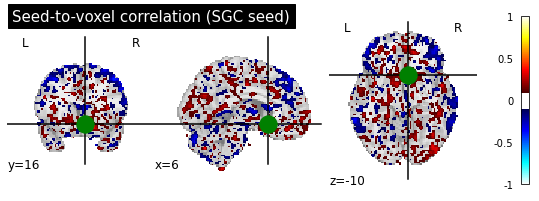

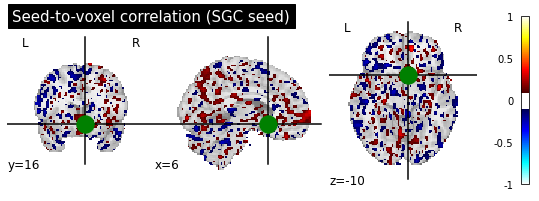

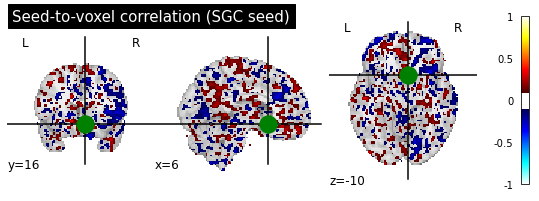

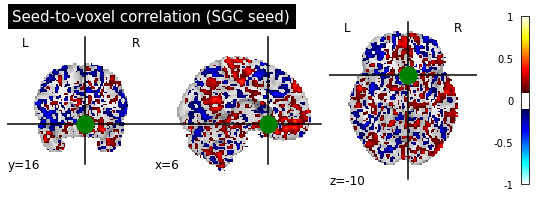

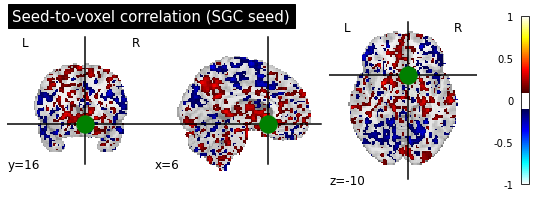

...

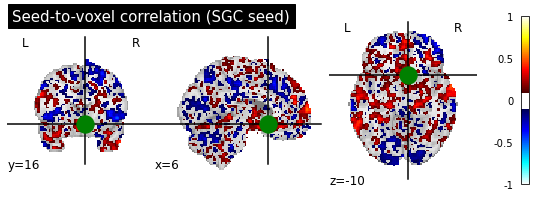

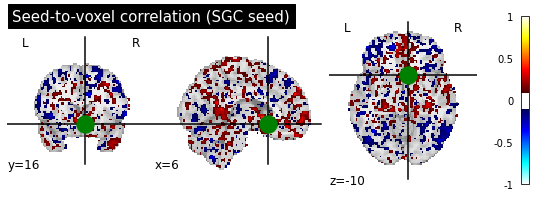

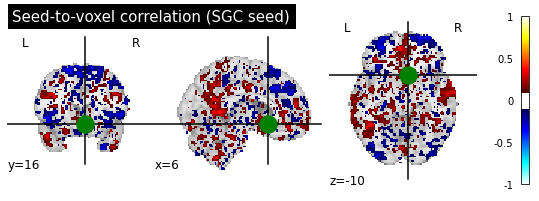

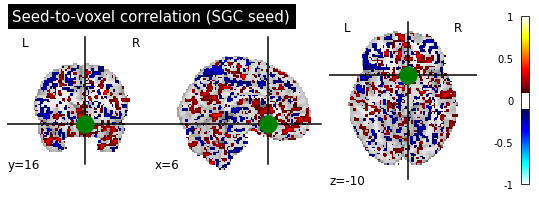

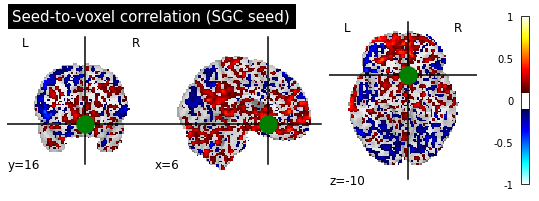

In [2]:
# SGC Z CORRELATION MAP BATCH GENERATION IMPLEMENTATION W/ FORMULAIC IMPLEMENTATION
# ***updated 4/24/23***

def corr2_coeff(A, B):
    A_bar = np.mean(A, axis=1) # flattens A
    A_bar = A_bar[:, np.newaxis]
    A_mA = A - A_bar
    B_mB = B - np.mean(B)
    
    
    # get dot product of every row of A_mA with B_mB
    numerators = A_mA.dot(B_mB)
    
    # Sum of squares
    A_sqs = np.sum(np.square(A_mA), axis=1) # get columnwise sum for A because A is a matrix
    B_sq = np.sum(np.square(B_mB))
    
    denoms = np.sqrt(A_sqs * B_sq) # scalar times vector 
    denoms = denoms[:, np.newaxis]
    
    # Finally get corr coeff
    return (numerators/denoms)

count = 0
start = timeit.default_timer()

# recursively iterates through subdirectories
# note: file of interest only exists within resting state subdirectories
for path in Path('/src/notebooks/S500_1/').rglob('*/MNINonLinear/Results/*/*_hp2000_clean.nii.gz'):
    out_dir = Path(Path.cwd().as_posix() + '/output/' + path.parts[3] + '/' + path.parts[4] + '/' + path.parts[7])
    out_file = Path(f'{out_dir}/sgc_seed_correlation_z.nii.gz')
    try:
        my_abs_path = out_file.resolve(strict=True)
    except FileNotFoundError:
        # doesn't exist
        out_dir.mkdir(parents=True)
        func_file = path.as_posix()

        sgc_coords=[(6, 16, -10)]
        seed_masker = NiftiSpheresMasker(sgc_coords, radius=10, detrend=True,
                                         standardize=True, low_pass=0.1,
                                         high_pass=0.01, t_r=0.72,
                                         memory='nilearn_cache',
                                         memory_level=1, verbose=0)

        global_image = NiftiMasker(smoothing_fwhm=0,
                                   detrend=True, standardize=True,
                                   low_pass=0.1, high_pass=0.01, t_r=0.72,
                                   memory='nilearn_cache', memory_level=1, verbose=0)

        brain_masker = NiftiMasker(smoothing_fwhm=4,
                                  detrend=True, standardize=True,
                                  low_pass=0.1, high_pass=0.01, t_r=0.72,
                                  memory='nilearn_cache', memory_level=1, verbose=0)

        mask = global_image.fit(func_file)
        gs = mask.fit_transform(func_file)

        brain_time_series = brain_masker.fit_transform(func_file, confounds=gs.mean(1))
        seed_time_series = seed_masker.fit_transform(func_file, confounds=gs.mean(1))

        #seed_to_voxel_correlations = (corr2_coeff(brain_time_series.T, seed_time_series))
        seed_to_voxel_correlations = (np.dot(brain_time_series.T, seed_time_series) /
                                  seed_time_series.shape[0]
                                  )
        seed_to_voxel_correlations_img = brain_masker.inverse_transform(seed_to_voxel_correlations.T)

        display = plotting.plot_stat_map(seed_to_voxel_correlations_img,
                                         threshold=0.1, vmax=1,
                                         cut_coords=sgc_coords[0],
                                         title="Seed-to-voxel correlation (SGC seed)"
                                         )
        display.add_markers(marker_coords=sgc_coords, marker_color='g',  marker_size=300)
        seed_to_voxel_correlations_fisher_z = np.arctanh(seed_to_voxel_correlations)
        print("Seed-to-voxel correlation Fisher-z transformed: min = %.3f; max = %.3f"
              % (seed_to_voxel_correlations_fisher_z.min(),
                 seed_to_voxel_correlations_fisher_z.max()
                 )
              )

        # Finally, we can transform the correlation array back to a Nifti image
        # object, that we can save.
        seed_to_voxel_correlations_fisher_z_img = brain_masker.inverse_transform(
            seed_to_voxel_correlations_fisher_z.T)
        seed_to_voxel_correlations_fisher_z_img.to_filename(out_file)
        
        count += 1
        stop = timeit.default_timer()
        elapsed = stop - start
        if elapsed >= 60:
            elapsed = elapsed / 60
        elif elapsed >= 3600:
            elapsed = elapsed / 3600
        print(f'Time elapsed to calculate {count} correlation map(s): {elapsed}')
        
    else:
        # file already exists
        continue


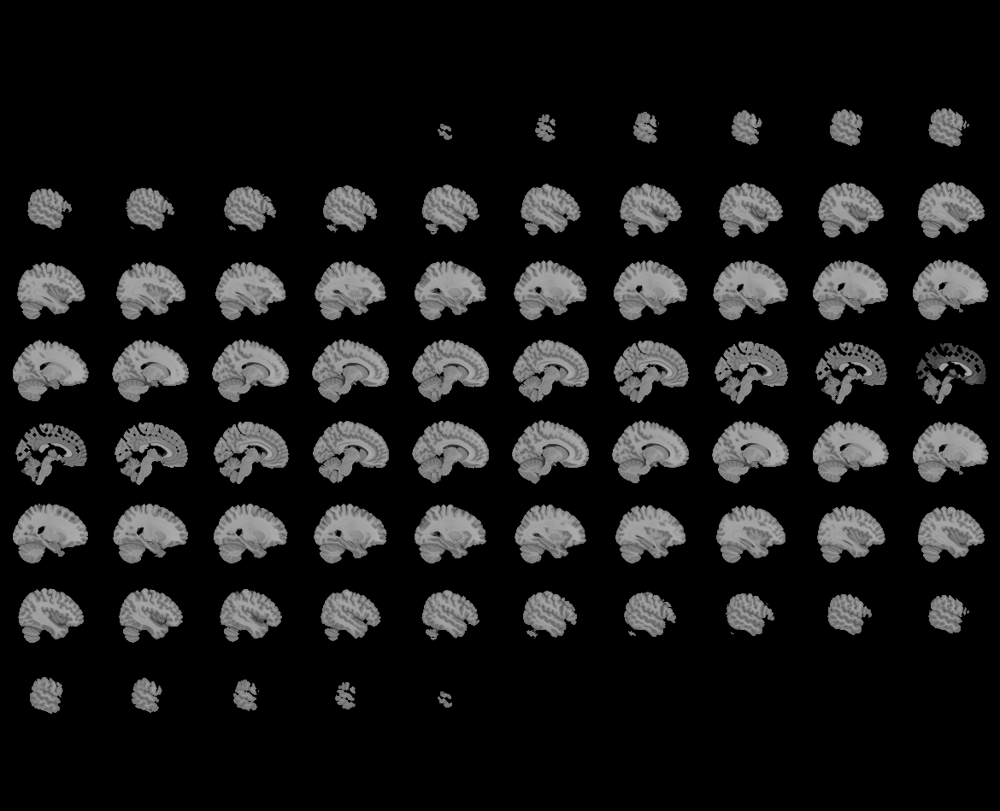
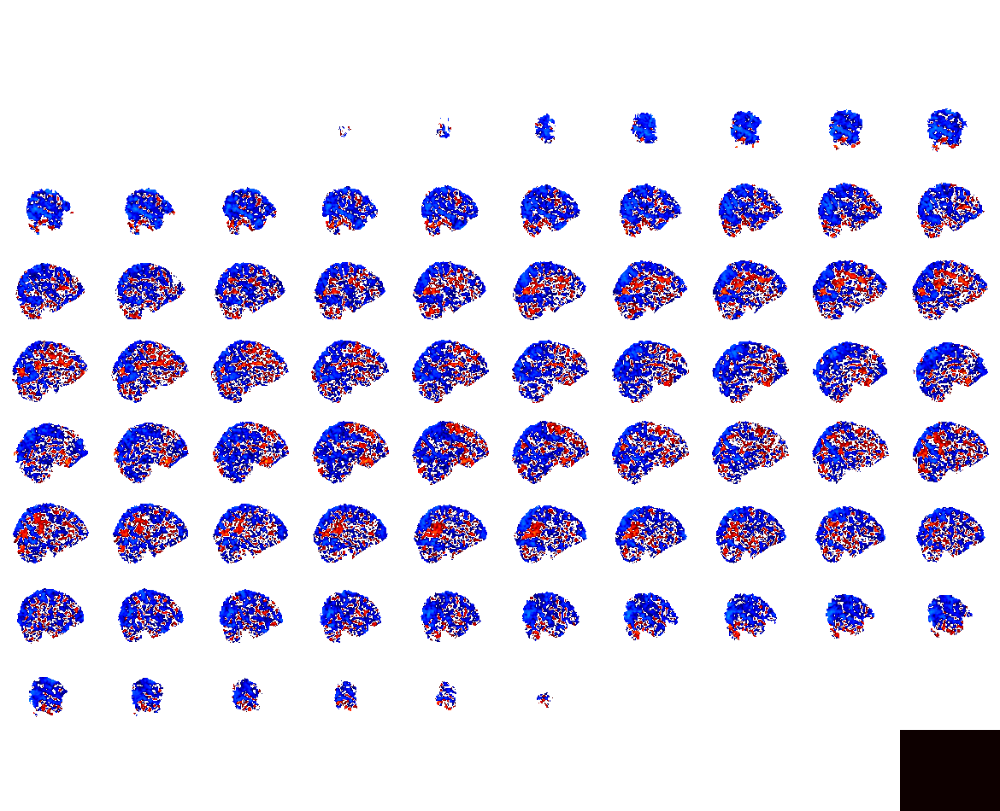

In [4]:
plotting.view_img(seed_to_voxel_correlations_img,
                                 threshold=0.1, vmax=1,
                                 cut_coords=sgc_coords[0],
                                 title="Seed-to-voxel correlation (SGC seed)"
                                 )

In [1]:
# SEED MAP GENERATION IMPLEMENTATION

from nilearn import image as nli

sgc_seed_correlation_z_imgs = []
for path in Path('/src/notebooks/output/S500_1/').rglob('*/*/sgc_seed_correlation_z.nii.gz'):
    sgc_seed_correlation_z_imgs.append(path.as_posix())
    
img = nli.mean_img(sgc_seed_correlation_z_imgs)
plotting.view_img(img, bg_img=img)
img.to_filename('/src/notebooks/sgc_seed_map.nii.gz')

/opt/conda/lib/python3.8/site-packages/nilearn/datasets/__init__.py:93: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  warn("Fetchers from the nilearn.datasets module will be "


/opt/conda/lib/python3.8/site-packages/nilearn/plotting/html_stat_map.py:217: FutureWarning: Default resolution of the MNI template will change from 2mm to 1mm in version 0.10.0
  bg_img = load_mni152_template()



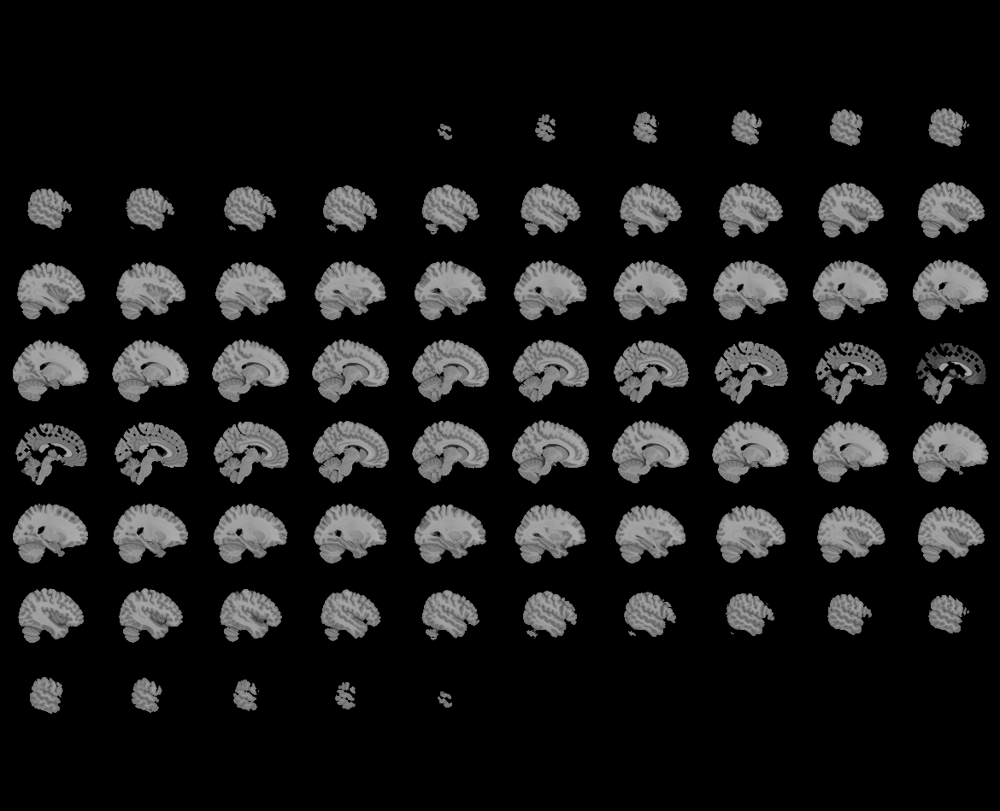
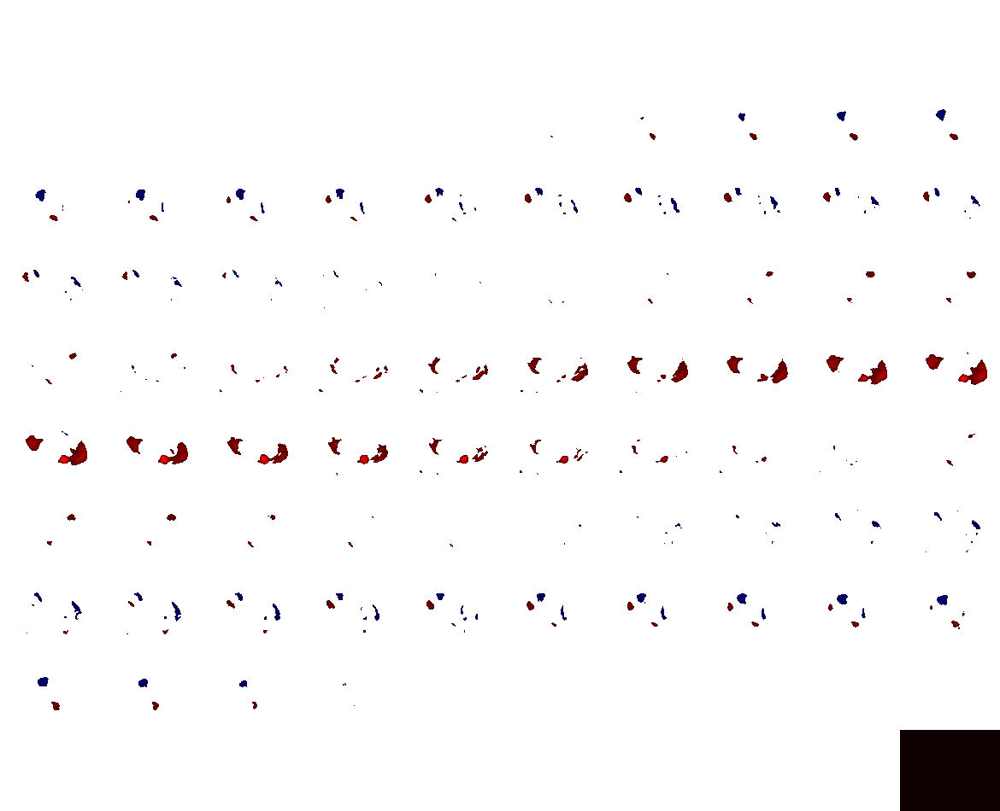

In [2]:
# plot for seed map
sgc_coords=[(6, 16, -10)] # seed coordinates

plotting.view_img(img,
                  threshold=0.1, vmax=1,
                  cut_coords=sgc_coords[0],
                  title="Seed-to-voxel correlation (SGC seed)")

In [5]:
# script to find distance between the peak negative value in the DLPFC and the TMS coil coordinates
# ***updated 6/16/23***

from nilearn import image as nli

func_file = '/src/notebooks/sgc_seed_map.nii.gz'
funcimg = nib.load(func_file)
funcmat = funcimg.get_fdata()
area = funcmat.reshape(np.prod(funcmat.shape))

maskimg = nli.load_img('/src/notebooks/DLPFC.nii.gz')
maskmat = maskimg.get_fdata()
mask = maskmat.reshape(np.prod(maskmat.shape))

dlpfc_ix = np.where(mask!=0)[0] 

dlpfc = np.zeros(area.shape)
# excluding everything except for the DLPFC from functional image
for i in range(area.shape[0]):
    if i in dlpfc_ix:
        dlpfc[i] = area[i]

new = dlpfc.reshape(91,109,91)
new[:43,:,:] = 0 # change all values in right hemisphere to zero
# gets the minimum argument among the voxels in the DLPFC and returns the voxel coordinates
peak_neg = np.unravel_index(new.argmin(), funcmat.shape)
peak_neg_mm = image.coord_transform(peak_neg[0], peak_neg[1], peak_neg[2], funcimg.affine)

coil_coords = pd.read_csv('/src/notebooks/sphere_centers.csv', sep=' ', names=['idn', 'x', 'y', 'z'])
idns, dists = [], []
for index, row in coil_coords.iterrows():
    idn = row['idn']
    idns.append(idn)
    
    coords = np.array([row['x'], row['y'], row['z']])
    squared_dist = np.sum((coords-np.array(peak_neg_mm))**2, axis=0)
    dist = np.sqrt(squared_dist)
    dists.append(dist)
    
    print(idn, '\t', dist)

combined = np.column_stack((idns,dists))
np.savetxt('/src/notebooks/distances.csv', combined, fmt='%s')

2.0 	 8.084501442344544
5.0 	 21.44972472215794
9.0 	 17.743540433975674
13.0 	 18.06107247525335
16.0 	 9.031568863996458
18.0 	 21.286766190413363
23.0 	 7.586361518049527
24.0 	 11.854460993863853
26.0 	 18.98280824636924
28.0 	 7.252783324619717
30.0 	 15.772930011864117
33.0 	 9.92730435924121
41.0 	 24.302191609947247
44.0 	 29.742115742977045
3.0 	 23.633079272925496
4.0 	 22.479815488237627
6.0 	 5.746110642021711
10.0 	 25.04662699583072
11.0 	 9.692665281459124
14.0 	 4.211994329840558
15.0 	 12.757860876591721
19.0 	 7.984179131033943
21.0 	 17.076283096353542
29.0 	 7.265499041822996
35.0 	 32.59987171944031
36.0 	 6.662125471363081
37.0 	 6.850365932701354
38.0 	 3.8231030617759965
39.0 	 26.519243243595607
40.0 	 15.183372234068939
43.0 	 32.33490553633739
45.0 	 30.591605441037952
46.0 	 nan
47.0 	 30.364104285761993
48.0 	 nan
49.0 	 34.47575957383584
50.0 	 22.063452866968078
52.0 	 14.28473356814789
53.0 	 22.738113486700918
54.0 	 nan


PermissionError: [Errno 13] Permission denied: '/src/notebooks/distances.csv'

### To get the grid numbers mount /data/rTMS in adrian

date and time = 10/06/2022 16:24:43


/tmp/ipykernel_12/1302660216.py:97: RuntimeWarning: invalid value encountered in arctanh
  seed_to_voxel_correlations_fisher_z = np.arctanh(seed_to_voxel_correlations)


Seed-to-voxel correlation Fisher-z transformed: min = nan; max = nan
date and time = 10/06/2022 16:25:41


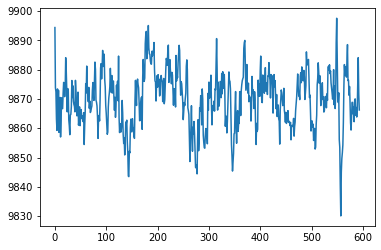

In [127]:
# DOT PRODUCT IMPLEMENTATION OF CORRELATION

from pathlib import Path
import os
from nilearn import plotting
import pylab as plt
import numpy as np
from nilearn import image as nli
from datetime import datetime
from nilearn import input_data

# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("date and time =", dt_string)	

bids_dir = '/src/notebooks/BIDS'

with open('/src/notebooks/info.txt', 'r') as f:
    lines = f.readlines()
     
    for line in lines:
        line = line.strip() # remove leading/trailing white spaces
        info = line.split()
        if not info:
            continue
        ses,sub,task,acq,run = info[0],info[1],info[2],info[3],info[4]
        
        grid_dir = '/src/notebooks/rTMS/%s/grid' % (ses)
        if sub == 'grid':
            if os.path.exists(grid_dir):
                with open(grid_dir, 'r') as grid: 
                    sub = grid.read().strip()              
            else:
                continue
        
        wrk_dir = '%s/ses-%s/sub-%s/MNINonLinear/Results/ses-%s_task-%s_acq-%s_run-%s_bold/ses-%s_task-%s_acq-%s_run-%s_bold_hp2000_clean.nii.gz' % (bids_dir, ses, sub, ses, task, acq, run, ses, task, acq, run)
        if not os.path.exists(wrk_dir):
            continue
            
        out_dir = '/src/notebooks/output/ses-%s_sub-%s_task-%s_acq-%s_run-%s' % (ses, sub, task, acq, run)
        out_file = '%s/SGC_seed_correlation_z.nii.gz' % (out_dir)
        if not os.path.exists(out_dir):
            os.mkdir(out_dir)
        
        # getting weights from seed map
        img = nli.load_img('/src/notebooks/sgc_seed_map.nii.gz')
        imgmat = img.get_fdata()
        weights = imgmat.reshape(np.prod(imgmat.shape))
        
        funcimg = nli.load_img(wrk_dir) # getting functional image
        
        # getting mask image of DLPFC and reshaping
        maskimg = nli.load_img('/src/notebooks/DLPFC.nii.gz')
        maskmat = maskimg.get_fdata()
        mask = maskmat.reshape(np.prod(maskmat.shape))

        ix = np.where(mask==0)[0] 
        funcmat = funcimg.get_fdata()
        area = funcmat.reshape([np.prod(funcmat.shape[0:3]), funcmat.shape[3]]).T # reshaping
        
        # excluding DLPFC from functional image
        area_X_dlpfc = area[:, ix].copy()
        weights_X_dlpfc = weights[ix,].copy()
        
        # matrix product of area without DLPFC and weights without DLPFC
        SGC_timecourse = np.matmul(area_X_dlpfc,weights_X_dlpfc)/weights_X_dlpfc.sum() 
        
        #_,ax = plt.subplots()
        #ax.plot(SGC_timecourse)
        
        sgc_coords=[(6, 16, -10)] # seed coordinates
        
        # creating resting state brain time series image
        brain_masker = input_data.NiftiMasker(
            smoothing_fwhm=6,
            detrend=True, standardize=True,
            low_pass=0.1, high_pass=0.01, t_r=2,
            memory='nilearn_cache', memory_level=1, verbose=0)
        brain_time_series = brain_masker.fit_transform(funcimg)
        
        # creating seed to voxel correlation map with scipy.signal.correlate
        seed_to_voxel_correlations = (np.dot(brain_time_series.T, SGC_timecourse) /
                              SGC_timecourse.shape[0])
        seed_to_voxel_correlations_img = brain_masker.inverse_transform(
            seed_to_voxel_correlations.T)
        
        # plotting seed to voxel correlation map
        display = plotting.plot_stat_map(seed_to_voxel_correlations_img, cut_coords=sgc_coords[0], vmax = 1,
                                         threshold = 0.1, title="Seed-to-voxel correlation (SGC seed)")
    
        # marker for SGC
        display.add_markers(marker_coords=sgc_coords, marker_color='g',
            marker_size=300)
        
        # Fisher-z transforming the data
        seed_to_voxel_correlations_fisher_z = np.arctanh(seed_to_voxel_correlations)
        print("Seed-to-voxel correlation Fisher-z transformed: min = %.3f; max = %.3f"
              % (seed_to_voxel_correlations_fisher_z.min(),
                 seed_to_voxel_correlations_fisher_z.max()
                 )
              )
        # transforming the correlation array back to a Nifti image object that we can save.
        seed_to_voxel_correlations_fisher_z_img = brain_masker.inverse_transform(
            seed_to_voxel_correlations_fisher_z.T)
        seed_to_voxel_correlations_fisher_z_img.to_filename(
            out_file)

        # datetime object containing current date and time
        now = datetime.now()
        dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
        print("date and time =", dt_string)	

date and time = 17/06/2022 15:03:01


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.94s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)
/opt/conda/lib/python3.8/site-packages/nilearn/plotting/img_plotting.py:341: FutureWarning: Default resolution of the MNI template will change from 2mm to 1mm in version 0.10.0
  anat_img = load_mni152_template()


Seed-to-voxel correlation Fisher-z transformed: min = -0.579; max = 0.679


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.40s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:04:14


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.78s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.440; max = 0.449


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.04s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:05:41
Seed-to-voxel correlation Fisher-z transformed: min = -0.579; max = 0.638


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.57s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:06:57


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.15s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.563; max = 0.644


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.54s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:08:18


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.02s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.553; max = 0.851


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.68s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:09:39


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.74s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.677; max = 0.781
date and time = 17/06/2022 15:10:56


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.14s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.481; max = 0.535


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.70s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:12:17


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.17s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.589; max = 0.689


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.82s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:13:36


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.76s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.703; max = 0.739


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.73s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:14:58


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.88s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.654; max = 0.566


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.66s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:16:16
Seed-to-voxel correlation Fisher-z transformed: min = -0.374; max = 0.617
date and time = 17/06/2022 15:17:33


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.57s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.644; max = 0.776


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.81s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:18:54


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.21s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.494; max = 0.549


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.71s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:20:14


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.91s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.428; max = 0.562
date and time = 17/06/2022 15:21:36


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.29s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.557; max = 0.682


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.75s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:22:56


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.80s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.645; max = 0.663


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.55s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:24:17


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.97s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.530; max = 0.455
date and time = 17/06/2022 15:25:39


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.07s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.679; max = 0.752
date and time = 17/06/2022 15:26:59


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.22s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.704; max = 0.752
date and time = 17/06/2022 15:28:20


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.47s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.492; max = 0.639
date and time = 17/06/2022 15:29:41


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.32s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)
/opt/conda/lib/python3.8/site-packages/nilearn/plotting/displays.py:666: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = plt.figure(figure, figsize=figsize,


Seed-to-voxel correlation Fisher-z transformed: min = -0.602; max = 0.740


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.85s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:31:05
Seed-to-voxel correlation Fisher-z transformed: min = -0.629; max = 0.772
date and time = 17/06/2022 15:32:27
Seed-to-voxel correlation Fisher-z transformed: min = -0.439; max = 0.610


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.13s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:33:49


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.71s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.512; max = 0.572
date and time = 17/06/2022 15:35:09
Seed-to-voxel correlation Fisher-z transformed: min = -0.633; max = 0.724


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.75s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:36:26
Seed-to-voxel correlation Fisher-z transformed: min = -0.426; max = 0.402


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.83s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:37:48


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.69s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.255; max = 0.466
date and time = 17/06/2022 15:39:10


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.92s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.317; max = 0.291
date and time = 17/06/2022 15:40:30


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.16s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.490; max = 0.584
date and time = 17/06/2022 15:41:52


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.28s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.680; max = 0.771
date and time = 17/06/2022 15:43:21


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.06s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.611; max = 0.566


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.43s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:44:44
Seed-to-voxel correlation Fisher-z transformed: min = -0.476; max = 0.508
date and time = 17/06/2022 15:46:06


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.93s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.383; max = 0.547
date and time = 17/06/2022 15:47:28


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.86s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.557; max = 0.542
date and time = 17/06/2022 15:48:52


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.87s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.733; max = 0.816
date and time = 17/06/2022 15:50:18
Seed-to-voxel correlation Fisher-z transformed: min = -0.544; max = 0.559
date and time = 17/06/2022 15:51:38
Seed-to-voxel correlation Fisher-z transformed: min = -0.688; max = 0.816


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.65s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:53:07


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.25s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.467; max = 0.632


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.12s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 15:54:26


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.60s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.516; max = 0.565
date and time = 17/06/2022 15:55:50
Seed-to-voxel correlation Fisher-z transformed: min = -0.495; max = 0.748
date and time = 17/06/2022 15:57:17


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.09s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.486; max = 0.598
date and time = 17/06/2022 15:58:42
Seed-to-voxel correlation Fisher-z transformed: min = -0.598; max = 0.596


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.01s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:00:04
Seed-to-voxel correlation Fisher-z transformed: min = -0.683; max = 0.701
date and time = 17/06/2022 16:01:29
Seed-to-voxel correlation Fisher-z transformed: min = -0.840; max = 0.799
date and time = 17/06/2022 16:02:57


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.64s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.564; max = 0.576
date and time = 17/06/2022 16:04:17


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 2.04s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.503; max = 0.727
date and time = 17/06/2022 16:05:44


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.05s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.558; max = 0.843
date and time = 17/06/2022 16:07:12
Seed-to-voxel correlation Fisher-z transformed: min = -0.684; max = 0.659


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.00s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:08:35
Seed-to-voxel correlation Fisher-z transformed: min = -0.408; max = 0.607
date and time = 17/06/2022 16:10:00


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.39s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.572; max = 0.700


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.24s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:11:27
Seed-to-voxel correlation Fisher-z transformed: min = -0.754; max = 0.707
date and time = 17/06/2022 16:12:56
Seed-to-voxel correlation Fisher-z transformed: min = -0.557; max = 0.573
date and time = 17/06/2022 16:14:22


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.96s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.615; max = 0.579


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.08s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:15:46


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.51s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.608; max = 0.821
date and time = 17/06/2022 16:17:08


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.95s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.350; max = 0.449
date and time = 17/06/2022 16:18:38


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.35s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.670; max = 0.914


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.38s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:20:40
Seed-to-voxel correlation Fisher-z transformed: min = -0.484; max = 0.666


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.63s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:22:08


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.03s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.613; max = 0.823
date and time = 17/06/2022 16:24:02


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.89s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.473; max = 0.604


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.62s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:25:34


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.94s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.425; max = 0.592


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.65s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:27:25
Seed-to-voxel correlation Fisher-z transformed: min = -0.277; max = 0.462
date and time = 17/06/2022 16:28:58


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.79s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.505; max = 0.506


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.50s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:30:12
Seed-to-voxel correlation Fisher-z transformed: min = -0.662; max = 0.722
date and time = 17/06/2022 16:31:26


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.81s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.462; max = 0.626


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.99s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


date and time = 17/06/2022 16:33:28


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.42s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.525; max = 0.518
date and time = 17/06/2022 16:36:09


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 0.98s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.479; max = 0.574
date and time = 17/06/2022 16:38:12


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 2.63s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.369; max = 0.715
date and time = 17/06/2022 16:40:49
Seed-to-voxel correlation Fisher-z transformed: min = -0.550; max = 0.497
date and time = 17/06/2022 16:43:27


/opt/conda/lib/python3.8/site-packages/nilearn/input_data/base_masker.py:289: UserWarning: Persisting input arguments took 1.36s to run.
If this happens often in your code, it can cause performance problems 
(results will be correct in all cases). 
The reason for this is probably some large input arguments for a wrapped
 function (e.g. large strings).
THIS IS A JOBLIB ISSUE. If you can, kindly provide the joblib's team with an
 example so that they can fix the problem.
  img = self._cache(masking.unmask)(X, self.mask_img_)


Seed-to-voxel correlation Fisher-z transformed: min = -0.553; max = 0.755
date and time = 17/06/2022 16:46:03


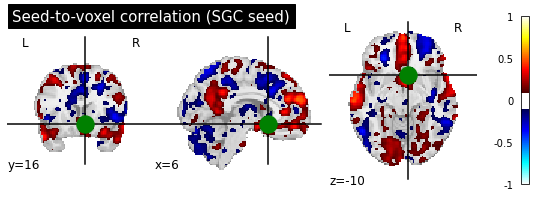

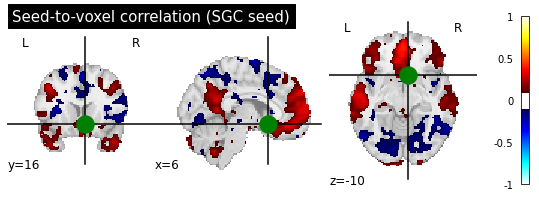

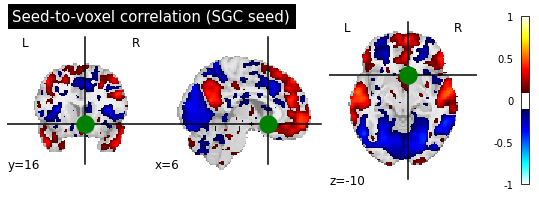

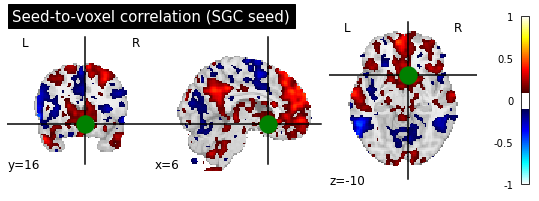

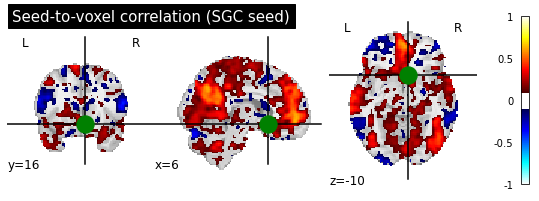

...

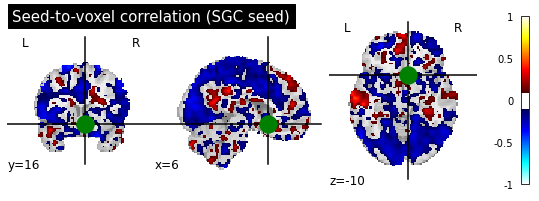

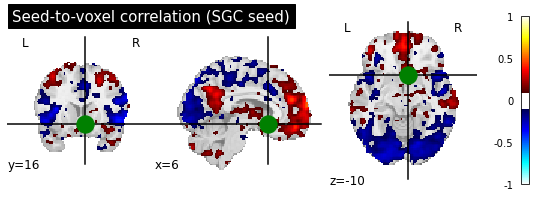

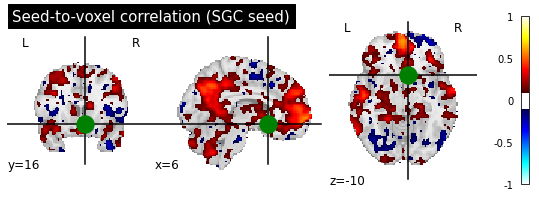

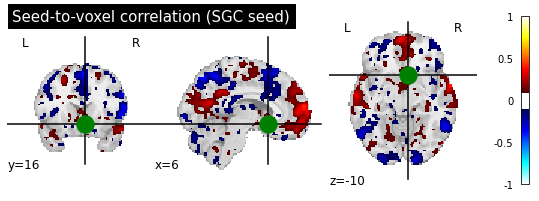

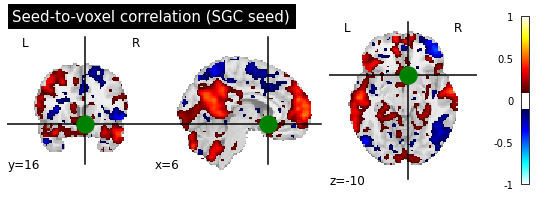

In [2]:
# FORMULAIC IMPLEMENTATION OF CORRELATION

import os
from nilearn import plotting
import pylab as plt
import numpy as np
from nilearn import image as nli
from datetime import datetime
from nilearn import input_data

def corr2_coeff(A, B):
    A_bar = np.mean(A, axis=1) # flattens A to be (594,) which is a 1D array. The problem is that A is (594, 221735) 
                               # so numpy's broadcasting doesn't know which axis to treat as the one to broadcast over
    A_bar = A_bar[:, np.newaxis] # by adding this extra dimension, we're forcing numpy to treat the 0th axis as the 
                                 # one to broadcast over which makes the next step possible. A_bar is now (594, 1)
    A_mA = A - A_bar 
    B_mB = B - np.mean(B)
    
    # get dot product of every row of A_mA with B_mB
    numerators = A_mA.dot(B_mB)
    
    # Sum of squares
    A_sqs = np.sum(np.square(A_mA), axis=1) # get columnwise sum for A because A is a matrix
    B_sq = np.sum(np.square(B_mB))
    denoms = np.sqrt(A_sqs * B_sq) # scalar times vector 

    # Finally get corr coeff
    return (numerators/denoms)

# datetime object containing current date and time
now = datetime.now()
dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
print("date and time =", dt_string)	

bids_dir = '/src/notebooks/BIDS'

with open('/src/notebooks/info.txt', 'r') as f:
    lines = f.readlines()
     
    for line in lines:
        line = line.strip() # remove leading/trailing white spaces
        info = line.split()
        if not info:
            continue
        ses,sub,task,acq,run = info[0],info[1],info[2],info[3],info[4]
        
        grid_dir = '/src/notebooks/rTMS/%s/grid' % (ses)
        if sub == 'grid':
            if os.path.exists(grid_dir):
                with open(grid_dir, 'r') as grid: 
                    sub = grid.read().strip()              
            else:
                continue
        
        wrk_dir = '%s/ses-%s/sub-%s/MNINonLinear/Results/ses-%s_task-%s_acq-%s_run-%s_bold/ses-%s_task-%s_acq-%s_run-%s_bold_hp2000_clean.nii.gz' % (bids_dir, ses, sub, ses, task, acq, run, ses, task, acq, run)
        if not os.path.exists(wrk_dir):
            continue    
            
        out_dir = '/src/notebooks/output/rTMS/ses-%s/sub-%s_task-%s_acq-%s_run-%s_bold' % (ses, sub, task, acq, run)

        if not os.path.exists(out_dir):
            os.makedirs(out_dir)
        
        # getting weights from seed map
        img = nli.load_img('/src/notebooks/sgc_seed_map.nii.gz')
        imgmat = img.get_fdata()
        weights = imgmat.reshape(np.prod(imgmat.shape))
        
        funcimg = nli.load_img(wrk_dir) # getting functional image
        
        # getting mask image of DLPFC and reshaping
        maskimg = nli.load_img('/src/notebooks/DLPFC.nii.gz')
        maskmat = maskimg.get_fdata()
        mask = maskmat.reshape(np.prod(maskmat.shape))

        ix = np.where(mask==0)[0] 
        funcmat = funcimg.get_fdata()
        area = funcmat.reshape([np.prod(funcmat.shape[0:3]), funcmat.shape[3]]).T # reshaping
        
        # excluding DLPFC from functional image
        area_X_dlpfc = area[:, ix].copy()
        weights_X_dlpfc = weights[ix,].copy()
        
        # matrix product of area without DLPFC and weights without DLPFC
        SGC_timecourse = np.matmul(area_X_dlpfc,weights_X_dlpfc)/weights_X_dlpfc.sum() 
        
        sgc_coords=[(6, 16, -10)] # seed coordinates
        
        # creating resting state brain time series image
        brain_masker = input_data.NiftiMasker(
            smoothing_fwhm=6,
            detrend=True, standardize=True,
            low_pass=0.1, high_pass=0.01, t_r=2,
            memory='nilearn_cache', memory_level=1, verbose=0)
        brain_time_series = brain_masker.fit_transform(funcimg)
        
        # creating seed to voxel correlation map with scipy.signal.correlate
        seed_to_voxel_correlations = (corr2_coeff(brain_time_series.T, SGC_timecourse))
        seed_to_voxel_correlations_img = brain_masker.inverse_transform(
            seed_to_voxel_correlations.T)
        
        # plotting seed to voxel correlation map
        display = plotting.plot_stat_map(seed_to_voxel_correlations_img, cut_coords=sgc_coords[0], vmax = 1,
                                         threshold = 0.1, title="Seed-to-voxel correlation (SGC seed)")
        # marker for SGC
        display.add_markers(marker_coords=sgc_coords, marker_color='g',
            marker_size=300)
        
        # Fisher-z transforming the data
        seed_to_voxel_correlations_fisher_z = np.arctanh(seed_to_voxel_correlations)
        print("Seed-to-voxel correlation Fisher-z transformed: min = %.3f; max = %.3f"
              % (seed_to_voxel_correlations_fisher_z.min(),
                 seed_to_voxel_correlations_fisher_z.max()
                 )
              )
        # transforming the correlation array back to a Nifti image object that we can save.
        seed_to_voxel_correlations_fisher_z_img = brain_masker.inverse_transform(
            seed_to_voxel_correlations_fisher_z.T)
        seed_to_voxel_correlations_fisher_z_img.to_filename(
            '%s/SGC_seed_correlation_z.nii.gz' % (out_dir))

        # datetime object containing current date and time
        now = datetime.now()
        dt_string = now.strftime("%d/%m/%Y %H:%M:%S")
        print("date and time =", dt_string)	

In [2]:
# MEAN SGC IMAGE CORRELATION MAP CROSSED WITH TMS COORDINATES
#this program finds the mean and median correlation values between the individual SGC image correlation map and the 
#coordinations for focalized rTMS

import os
from nilearn import plotting
import pylab as plt
import numpy as np
from nilearn import image as nli
from datetime import datetime
from nilearn import masking
import csv

#initialize csv file to hold TMS analysis data
header = ['SESSION_NUM', 'ID', 'MEAN', 'MEDIAN', 'ACQ', 'SPHERE_SIZE']
with open('/src/notebooks/output/TMS_Analysis.csv', 'w') as f:
    writer = csv.writer(f)
    writer.writerow(header)

with open('/src/notebooks/ID.txt', 'r') as f:
    lines = f.readlines()
     
    for line in lines:
        line = line.strip() # remove leading/trailing white spaces
        info = line.split()
        if not info:
            continue
        ses,acq,num = info[0],info[1],info[2]
        size = 'Big' # intialize to big sphere
        
        # looping between sphere masks
        for x in range(2):
            data = [] # initialize array to hold data 
            
            sphere_f = '/src/notebooks/TMS_Analysis/{0}Sphere_{1}.nii.gz'.format(size, num)
            if not os.path.exists(sphere_f):
                continue
            sphereimg = nli.load_img(sphere_f)
            spheremat = sphereimg.get_fdata()
            sphere = spheremat.reshape(np.prod(spheremat.shape)) # reshape sphere mask to 1D
                    
            corrmapimg = nli.load_img('/src/notebooks/output/rTMS/ses-{0}/sub-*_task-rest_acq-{1}_run-01_bold/SGC_seed_correlation_z.nii.gz'.format(ses, acq))
            corrmapmat = corrmapimg.get_fdata()
            corrmap = corrmapmat.reshape(np.prod(corrmapmat.shape)) # reshape correlation map mask to 1D
            
            ix_sphere = np.where(sphere>0)[0] # get nonzero values within sphere mask
            corrmap_X_sphere = corrmap[ix_sphere,].copy() # isolate voxels within the correlation map that are 
                                                          # within the sphere mask
            corrmap_X_sphere[corrmap_X_sphere==0] = np.nan # convert zero values within intersection of the correlation 
                                                           # map and the sphere mask to NaNs
            
            sample_size = corrmap_X_sphere.shape[0] - sum(np.isnan(corrmap_X_sphere)) # calculation for sample size
            if sample_size >= 10: # if sample of voxels is greater than 10, calculate the median
                med = np.nanmedian(corrmap_X_sphere)
                mean = np.nanmean(corrmap_X_sphere)
            else: # if sample of voxels is less than 10, set median and mean to 'Not a Number'
                med = np.nan 
                mean = np.nan
            
            if size == '':
                size = 'Small'
            
            data.extend([ses, num, mean, med, acq, size])
            with open('/src/notebooks/output/TMS_Analysis.csv', 'a') as f:
                writer = csv.writer(f)
                writer.writerow(data)
                
            size = '' # switch to small sphere

date and time = 22/06/2022 17:57:51
date and time = 22/06/2022 17:57:52
date and time = 22/06/2022 17:57:52
date and time = 22/06/2022 17:57:53
date and time = 22/06/2022 17:57:53
date and time = 22/06/2022 17:57:53
date and time = 22/06/2022 17:57:53
date and time = 22/06/2022 17:57:54
date and time = 22/06/2022 17:57:55
date and time = 22/06/2022 17:57:55
date and time = 22/06/2022 17:57:56
date and time = 22/06/2022 17:57:56
date and time = 22/06/2022 17:57:57
date and time = 22/06/2022 17:57:57
date and time = 22/06/2022 17:57:58
date and time = 22/06/2022 17:57:58
date and time = 22/06/2022 17:57:59
date and time = 22/06/2022 17:57:59
date and time = 22/06/2022 17:57:59
date and time = 22/06/2022 17:57:59
date and time = 22/06/2022 17:57:59
date and time = 22/06/2022 17:57:59
date and time = 22/06/2022 17:58:00
date and time = 22/06/2022 17:58:00
date and time = 22/06/2022 17:58:01
date and time = 22/06/2022 17:58:01
date and time = 22/06/2022 17:58:01
date and time = 22/06/2022 1

In [262]:
# script to find distance between the peak negative INDIVIDUAL value in the DLPFC and the TMS coil coordinates
# ***updated 12/22/23***

from nilearn import image as nli
import os

func_file = '/src/notebooks/sgc_seed_map.nii.gz'
funcimg = nib.load(func_file)
funcmat = funcimg.get_fdata()
area = funcmat.reshape(np.prod(funcmat.shape))

#maskimg = nli.load_img('/src/notebooks/L-DLPFC.nii')
maskimg = nli.load_img('/src/notebooks/NEW-DLPFC.nii')
maskmat = maskimg.get_fdata()
mask = maskmat.reshape(np.prod(maskmat.shape))

dlpfc_ix = np.where(mask!=0)[0] 

dlpfc = np.zeros(area.shape)
# excluding everything except for the DLPFC from functional image
for i in range(area.shape[0]):
    if i in dlpfc_ix:
        dlpfc[i] = area[i]

new = dlpfc.reshape(91,109,91)
#new[:43,:,:] = 0 # change all values in right hemisphere to zero
# gets the minimum argument among the voxels in the DLPFC and returns the voxel coordinates

coil_coords = pd.read_csv('/src/notebooks/sphere_centers_2.csv', sep=' ', names=['idn', 'x', 'y', 'z'])
mycoords, idns, dists, peaks, corrmins = [], [], [], [], []
for index, row in coil_coords.iterrows():
    idn = row['idn']
    if (len(np.where(sessid['ID']==idn)[0])==0):
        ses=''
        grid=''
    else:
        ses = str(sessid['SESSION_NUM'].iloc[np.where(sessid['ID']==idn)].values[0])
        grid = os.listdir('/src/notebooks/output/rTMS/ses-{0}'.format(ses))[0].split('-')[1].split('_')[0]
    
    #func_file = '/src/notebooks/sgc_seed_map.nii.gz'
    func_file = '/src/notebooks/output/rTMS/ses-{0}/sub-{1}_task-rest_acq-PA_run-01_bold/SGC_seed_correlation_z.nii.gz'.format(ses, grid)
    if (os.path.isfile(func_file)):
        #funcimg = nib.load(func_file)
        funcimg = image.smooth_img(func_file, fwhm=6)
        funcmat = funcimg.get_fdata()
        area = funcmat.reshape(np.prod(funcmat.shape))
        dlpfc_ix = np.where(mask!=0)[0] 
        dlpfc = np.zeros(area.shape)
        # excluding everything except for the DLPFC from functional image
        #for i in range(area.shape[0]):
        #    if i in dlpfc_ix:
        #        dlpfc[i] = area[i]
        dlpfc[dlpfc_ix]=area[dlpfc_ix]
        new = dlpfc.reshape(91,109,91)
        #new[:43,:,:] = 0 # change all values in right hemisphere to zero
        peak_neg = np.unravel_index(new.argmin(), funcmat.shape)
        peak_neg_mm = image.coord_transform(peak_neg[0], peak_neg[1], peak_neg[2], maskimg.affine)
        corrmins.append(new.min())
        idn = row['idn']
        idns.append(idn)
        peaks.append(peak_neg_mm)
        coords = np.array([row['x'], row['y'], row['z']])
        squared_dist = np.sum((coords-np.array(peak_neg_mm))**2, axis=0)
        dist = np.sqrt(squared_dist)
        dists.append(dist)
        mycoords.append(row[['x','y','z']])
        #print(idn, '\t', ' - ' , '\t', func_file)

combined = np.column_stack((idns,dists, corrmins))
#np.savetxt('/src/notebooks/distances-individ-N35.csv', combined, fmt='%s')

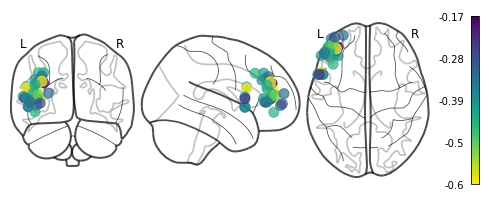

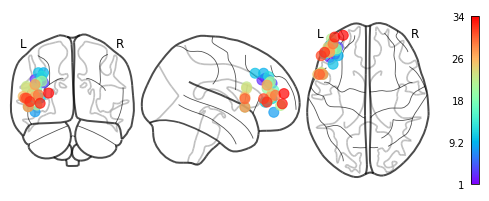

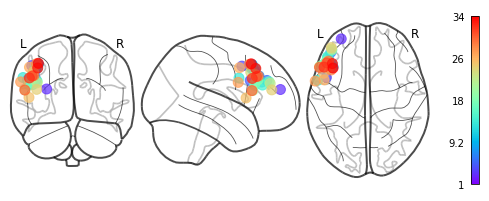

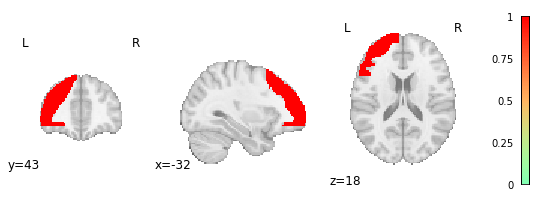

In [263]:
peakarr=np.array(peaks)
t = np.ones(peakarr.shape[0])
mycolors=['black','green','red','blue','orange','yellow']
plotting.plot_markers(np.array(corrmins),peakarr)


plotting.plot_markers(np.ones(np.array(mycoords).shape[0])+range(34),peakarr, node_cmap='rainbow')

plotting.plot_markers(np.ones(np.array(mycoords).shape[0])+range(34),np.array(mycoords), node_cmap='rainbow')
plotting.plot_stat_map(maskimg, black_bg=False, cmap='rainbow', draw_cross=False, cut_coords=(-32,43,18))

In [264]:
coil_coords = pd.read_csv('/src/notebooks/sphere_centers_2.csv', sep=' ', names=['idn', 'x', 'y', 'z'])
#coil_coords

## TMS Locations across subjects

### 2 examples

In [270]:

df=pd.read_csv('/src/notebooks/TMS/2example.csv')

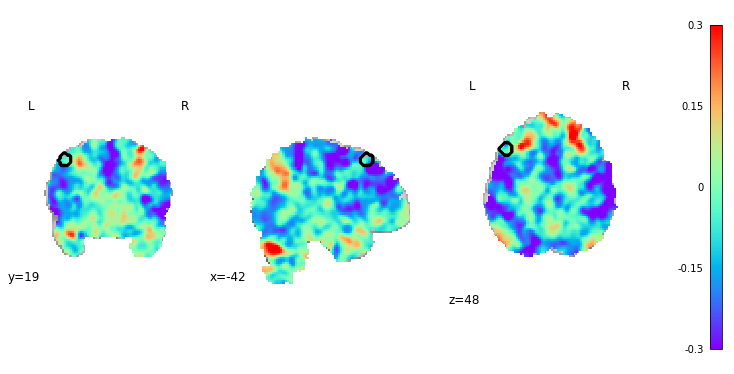

In [272]:
import pandas as pd
import matplotlib.pyplot as plt
data = pd.read_csv('/src/notebooks/output/TMS_Analysis.csv')
import nilearn.plotting as plotting
fig = plt.figure(figsize=(10, 5))

i=df['id'].iloc[0]
ses=df['ses'].iloc[0]
grid=df['grid'].iloc[0]
display=plotting.plot_stat_map('/src/notebooks/output/rTMS/ses-' + str(ses) + '/sub-'+str(grid)+'_task-rest_acq-PA_run-01_bold/SGC_seed_correlation_z.nii.gz' , cmap='rainbow',draw_cross=False, figure=fig,cut_coords=(-42,19,48), vmax=0.3)
display.add_contours('/src/notebooks/output/spheres/Sphere_' + str(i) + '.nii.gz', colors='black')

plotting.show()

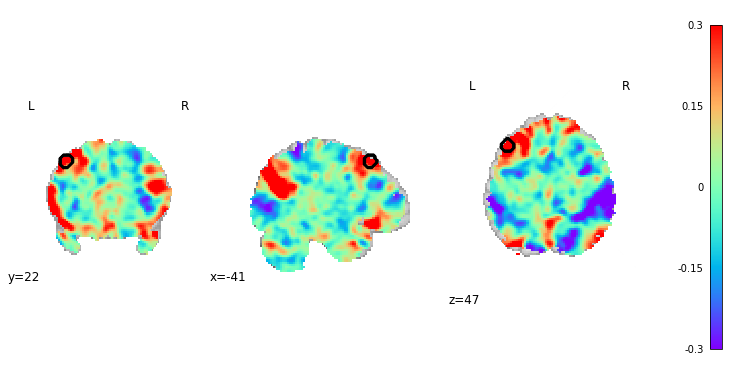

In [273]:

fig = plt.figure(figsize=(10, 5))

i=df['id'].iloc[1]
ses=df['ses'].iloc[1]
grid=df['grid'].iloc[1]

display=plotting.plot_stat_map('/src/notebooks/output/rTMS/ses-'+str(ses)+'/sub-'+str(grid)+'_task-rest_acq-PA_run-01_bold/SGC_seed_correlation_z.nii.gz' , cmap='rainbow', vmax=0.3,draw_cross=False, figure=fig,cut_coords=(-41,22,47))
display.add_contours('/src/notebooks/output/spheres/Sphere_' + str(i) + '.nii.gz', colors='black')

plotting.show()

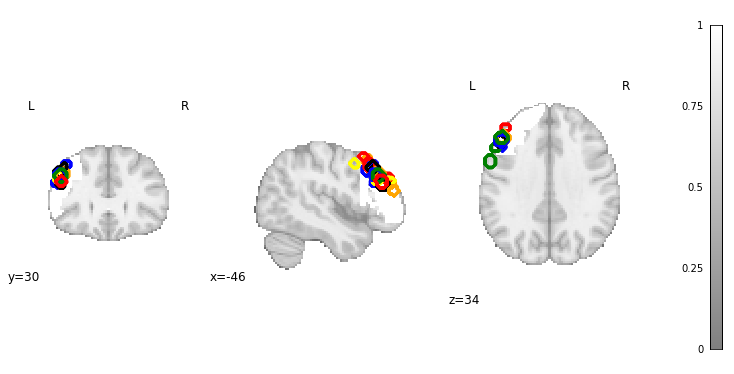

In [274]:
import pandas as pd
import matplotlib.pyplot as plt
data = pd.read_csv('/src/notebooks/output/TMS_Analysis.csv')
import nilearn.plotting as plotting
fig = plt.figure(figsize=(10, 5))

mycolors=['black','green','red','blue','orange','yellow']
display=plotting.plot_stat_map('/src/notebooks/NEW-DLPFC.nii' , cmap='gray', draw_cross=False, figure=fig,cut_coords=(-46,30,34))
for i in data['ID']:
    display.add_contours('/src/notebooks/output/spheres/Sphere_' + str(i) + '.nii.gz', colors=mycolors[i%6])
plotting.show()